# Aberration Analysis in Zeeman Apparatus Optical System

## Import Modules

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks
from scipy.optimize import curve_fit
from scipy.interpolate import UnivariateSpline

## Constants 

In [2]:
dataPath = './Data/'
outputPath = './Plots/trends/'


projections = [
                'scan_585_z1_04_proj.txt',
                'scan_585_z1_05_proj.txt',
                'scan_585_z1_06_proj.txt',
                'scan_585_z1_07_proj.txt',
                'scan_585_z1_08_proj.txt',
                'scan_585_z1_09_proj.txt',
                'scan_585_z1_10_proj.txt',
                'scan_640_z1_01_proj.txt',
                'scan_640_z1_02_proj.txt'
            ]

startValues = [
                300,
                300,
                300,
                300,
                300,
                300,
                300,
                300,
                300
            ]

endValues = [
                3050,
                3135,
                3150,
                3080,
                3150,
                3150,
                3060,
                4300,
                4230
            ]

slicePeaks = [startValues, endValues]

filenames = [
                'scan_585_z1_04_data.txt',
                'scan_585_z1_05_data.txt',
                'scan_585_z1_06_data.txt',
                'scan_585_z1_07_data.txt',
                'scan_585_z1_08_data.txt',
                'scan_585_z1_09_data.txt',
                'scan_585_z1_10_data.txt',
                'scan_640_z1_01_data.txt',
                'scan_640_z1_02_data.txt'
            ]

binFrac = 3
beg = 0
stp = 7926

## Fit Functions

In [3]:
def lin(x, a, b):
    return a*x + b

def parab(x, a, b, c):
    return a*x**2 + b*x + c

def cub(x, a, b, c, d):
    return a*x**3 + b*x**2 + c*x + d

def Gauss(x, N, x0, sigma):
    return N/(2*np.pi)**0.5 / sigma * np.exp(-(x - x0)**2 / (2 * sigma**2))

## Chi2 Functions

In [4]:
def chi2_cub(x, y, err, a, b, c, d):
    chisq=0

    for i in range(len(x)):
        chisq += (y[i] - (a*x[i]**3+b*x[i]**2+c*x[i]+d))**2 / err[i]**2

    return chisq

def chi2_parab(x, y, err, a, b, c):
    chisq=0

    for i in range(len(x)):
        chisq += (y[i] - (a*x[i]**2+b*x[i]+c))**2 / err[i]**2

    return chisq

## Projection Data Reader Function


In [5]:
# read data from txt file
def readProj(fname):
    # read raw data
    data = pd.read_csv(dataPath + fname, sep = '\t', header = None, names = ['X', 'Y'])

    # change bins and get new y
    newY, edge= np.histogram(data.X, weights=data.Y, bins=int(len(data.X)/binFrac))

    # get new x
    newX = []
    for i in range(len(edge)-1):
        newX.append((edge[i]+edge[i+1])/2)

    # save new data in a Pandassssss dataframe
    data = pd.DataFrame(list(zip(newX,newY)), columns=['X','Y'])

    return data

## Trend Data Reader Function

In [6]:
# read data from txt file
def readData(fname):

    # read raw data
    data = np.loadtxt(dataPath + fname, delimiter=';')

    return data

## 0 - Find Peaks 

In [7]:
proj = []
for fname in projections:
    proj.append(readProj(fname))

In [8]:
newProj = []
for i, (start, stop) in enumerate(np.array(slicePeaks).T.tolist()):
    newProj.append(proj[i][(proj[i]['X']>start) & (proj[i]['X']<stop)])
    newProj[i].reset_index(inplace = True, drop = True)

In [9]:

gaussParameters = []

for j, sample in enumerate(newProj):

    gaussianFitParameters = []
    peaks, p = find_peaks(sample['Y'], width=5, prominence=100, rel_height=0.7)

    for i in range(len(peaks)):

        # get fit data
        tr=int((p['right_ips'][i] - p['left_ips'][i])/5)
        xfit=sample['X'].iloc[round(p['left_ips'][i]-tr):round(p['right_ips'][i])+tr]
        yfit=sample['Y'].iloc[round(p['left_ips'][i]-tr):round(p['right_ips'][i])+tr]

        # initial parameters
        mean0=np.average(xfit)
        std0=np.std(xfit)
        # normalization parameter
        ngau=np.sum(yfit*binFrac)

        # fit current peak
        par, cov = curve_fit(lambda x,mean,stddev: Gauss(x,ngau,mean,stddev),
                             xfit, yfit, p0=[mean0, std0])

        errors = np.zeros(len(par))

        for k in range(len(par)):
            try:
                errors[k] = cov[k][k]**0.5
            except:
                errors[k] = 0.00

        mu = par[0]
        sigma = par[1]
        err_mu = errors[0]
        err_sigma = errors[1]

        gaussianFitParameters.append(np.array([mu, err_mu, sigma, err_sigma]))

    gaussParameters.append(gaussianFitParameters)
    
    # gaussParameters[sample][peak][mu, err_mu, sigma, err_sigma]

## 1 - EDA

In [191]:
# DATA FORMAT: POSITION - SPACING - FWHM    
data = []        
for fname in filenames:
    data.append(readData(fname))

# data[sample][peak][position, spacing, fwhm]
# gaussParameters[sample][peak][mu, err_mu, sigma, err_sigma]
# devo associaare ad ogni picco del sample l'errore sulla posizione mu

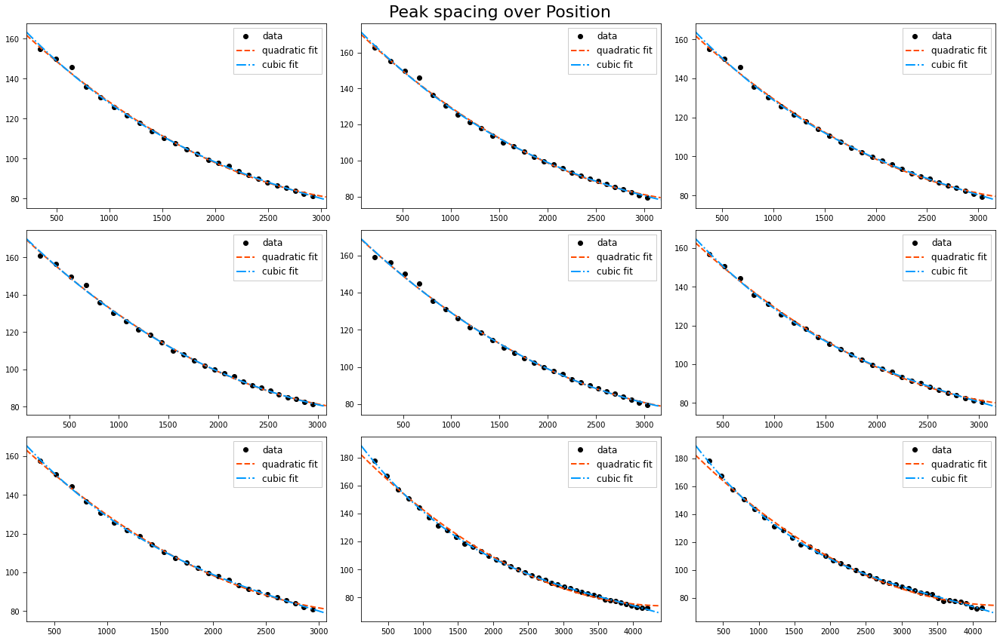

In [192]:
fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('Peak spacing over Position', fontsize = 22)

par_cub = []
par_parab = []

h = 0
for i in range(3):
    for j in range(3):
        dataset = np.array(data[i+j+h])

        peakPositions = dataset[:,0]
        peakSpacing = dataset[:,1]

        DELTAX = peakPositions[-1] - peakPositions[0]
        XMIN = peakPositions[0] - DELTAX * 5/100
        XMAX = peakPositions[-1] + DELTAX * 5/100
        x_grid = np.linspace(XMIN, XMAX, 1000)

        par1, cov1 = curve_fit(parab, peakPositions, peakSpacing)
        par2, cov2 = curve_fit(cub, peakPositions, peakSpacing)

        
        ax[i][j].plot(peakPositions, peakSpacing, marker = '.', markersize = 12, linewidth = 0, color = '#000000', label = 'data', zorder = 0)
        ax[i][j].plot(x_grid, parab(x_grid, *par1), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dashed', color = '#FF4B00', label = 'quadratic fit', zorder = 1)
        ax[i][j].plot(x_grid, cub(x_grid, *par2), marker = '.', markersize = 0, linewidth = 2, linestyle = '-.', color = '#009AFF', label = 'cubic fit', zorder = 2)

        ax[i][j].set_xlim(XMIN, XMAX)
        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)
        ax[i][j].legend(loc = 'upper right', prop = {'size': 12}, ncol = 1, frameon = True, fancybox = False, framealpha = 1)

        par_parab.append(par1)
        par_cub.append(par2)
    h+=2
fig.tight_layout()

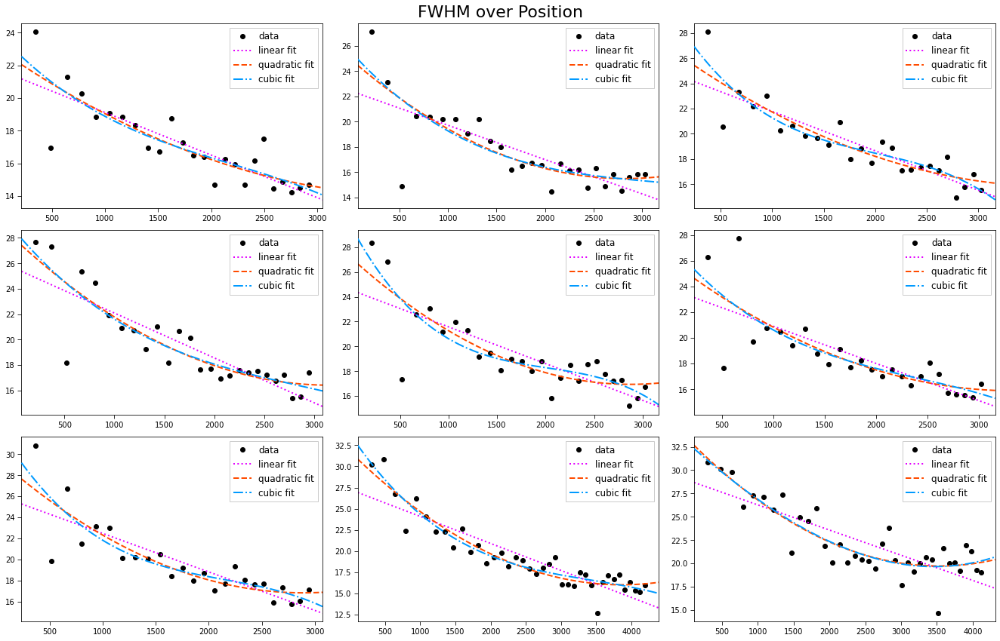

In [193]:
fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('FWHM over Position', fontsize = 22)

par_lin = []
par_cub = []
par_parab = []

h = 0
for i in range(3):
    for j in range(3):
        dataset = np.array(data[i+j+h])

        peakPositions = dataset[:,0]
        peakFWHM = dataset[:,2]

        DELTAX = peakPositions[-1] - peakPositions[0]
        XMIN = peakPositions[0] - DELTAX * 5/100
        XMAX = peakPositions[-1] + DELTAX * 5/100
        x_grid = np.linspace(XMIN, XMAX, 1000)

        par1, cov1 = curve_fit(lin, peakPositions, peakFWHM)
        par2, cov2 = curve_fit(parab, peakPositions, peakFWHM)
        par3, cov3 = curve_fit(cub, peakPositions, peakFWHM)

        
        ax[i][j].plot(peakPositions, peakFWHM, marker = '.', markersize = 12, linewidth = 0, color = '#000000', label = 'data', zorder = 0)
        ax[i][j].plot(x_grid, lin(x_grid, *par1), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dotted', color = '#e300ff', label = 'linear fit', zorder = 1)
        ax[i][j].plot(x_grid, parab(x_grid, *par2), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dashed', color = '#FF4B00', label = 'quadratic fit', zorder = 2)
        ax[i][j].plot(x_grid, cub(x_grid, *par3), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dashdot', color = '#009AFF', label = 'cubic fit', zorder = 3)

        ax[i][j].set_xlim(XMIN, XMAX)
        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)
        ax[i][j].legend(loc = 'upper right', prop = {'size': 12}, ncol = 1, frameon = True, fancybox = False, framealpha = 1)

        par_lin.append(par1)
        par_parab.append(par2)
        par_cub.append(par3)
    h+=2
fig.tight_layout()
# fig.savefig(outputPath + 'grid' + '_FWHM.png', dpi = 500, facecolor = 'white')

## 2 - Data Manipulation

In [194]:
# deleting first elemnts to make data more uniform
newData = []
for dataset in data:

    if dataset[0, 0] < 300:
        newDataset = np.delete(dataset, 0, axis=0)
    else:
        newDataset = np.copy(dataset)

    # deleting last elements in order to have samples with the same amount of datapoints
    # if len(newDataset)>25 and len(newDataset)<30:
        # newNewDataset = np.delete(newDataset, np.s_[25:], axis=0)
    # else:
        # newNewDataset = np.copy(newDataset)

    # newData.append(newNewDataset)
    newData.append(newDataset)
data = newData

In [195]:
# concatenating gaussian fit parameters
newData = []
for i, sample in enumerate(data):
    sampleArray = []
    for j, peak in enumerate(sample):
        sampleArray.append(np.array(np.concatenate( (peak, gaussParameters[i][j]) , axis=0)))
    newData.append(sampleArray)

data = newData
# data[sample][peak][position, spacing, fwhm, mu, err_mu, sigma, err_sigma]

## 3 - Error Estimation

First trial: take the standard deviation for each position from all samples 

In [142]:
# points = np.empty((24,7))
# for i, dataset in enumerate(spacingData):
#     if len(dataset)==24:
#         for j in range(len(dataset)):
#             points[j,i] = dataset[j,1]

In [155]:
# stdevs = []
# for point in points:
#     std = np.std(point)
#     stdevs.append(std)
# stdevs=np.array(stdevs)

In [170]:
# spacingData_ = []
# for sample in spacingData[:-2]:
#     spacingData_.append(np.column_stack((sample, stdevs)))

In [222]:
# points = np.empty((24,7))
# for i, dataset in enumerate(fwhmData):
#     if len(dataset)==24:
#         for j in range(len(dataset)):
#             points[j,i] = dataset[j,1]

In [223]:
# stdevs = []
# for point in points:
#     std = np.std(point)
#     stdevs.append(std)
# stdevs=np.array(stdevs)

In [224]:
# fwhmData_ = []
# for sample in fwhmData[:-2]:
#     fwhmData_.append(np.column_stack((sample, stdevs)))

Second trial: use gaussian fit parameter errors

In [197]:
# spacing error propagation

def quadraticSum(a, b):
    return a**2 + b**2

def weightedMean(erra, errb):
    # w = ( (a/erra**2)+(b/errb**2) ) / ( 1/erra**2 + 1/errb**2 )
    s = np.sqrt( 1 / ( 1/erra**2 + 1/errb**2 ) )
    return s

def errSpacing(errors):
    errC = []
    sigma = []
    for i in range(1, len(errors)):
        errC.append(np.sqrt(quadraticSum(errors[i], errors[i-1])))
    for i in range(1, len(errC)):
        sigma.append(weightedMean(errC[i], errC[i-1]))
    
    sigma.insert(0,sigma[0])
    sigma.insert(-1,sigma[-1])
    return np.array(sigma)

In [198]:
spacing_err = []

# data[sample][peak][position, spacing, fwhm, mu, err_mu, sigma, err_sigma]

for i, sample in enumerate(data):
    # sample[peak][position, spacing, fwhm, mu, err_mu, sigma, err_sigma]

    pos_err = []

    for j, peak in enumerate(sample):
        pos_err.append(peak[4])

    # print(errSpacing(np.array(pos_err)))
    spacing_err.append(errSpacing(np.array(pos_err)))     

In [199]:
# concatenating spacing errors

newData = []
for i, sample in enumerate(data):
    sampleArray = []
    for j, peak in enumerate(sample):
        sampleArray.append(np.array(np.concatenate( (peak, [spacing_err[i][j]]) , axis=0)))
    newData.append(sampleArray)

data = newData
# data[sample][peak][position, spacing, fwhm, mu, err_mu, sigma, err_sigma, err_spacing]

In [200]:
# FWHM error propagation

fwhm_errors = []

for sample in data:
    sample_fwhm_errors = []
    for peak in sample:
        sample_fwhm_errors.append(peak[6]*2.355)
    fwhm_errors.append(np.array(sample_fwhm_errors))

In [201]:
# concatenating fwhm errors

newData = []
for i, sample in enumerate(data):
    sampleArray = []
    for j, peak in enumerate(sample):
        sampleArray.append(np.array(np.concatenate( (peak, [fwhm_errors[i][j]]) , axis=0)))
    newData.append(sampleArray)

data = newData
# data[sample][peak][position, spacing, fwhm, mu, err_mu, sigma, err_sigma, err_spacing, err_fwhm]

In [210]:
# deleting the third element (always above trend in spacing)

spacingData = []
for dataset in data:
    newDataset = np.delete(dataset, 2, axis=0)
    spacingData.append(newDataset)

In [211]:
# deleting the second element (always below trend in fwhm)

fwhmData = []
for dataset in newData:
    newDataset = np.delete(dataset, 1, axis=0)
    fwhmData.append(newDataset)

## 4 - Fitting Data 

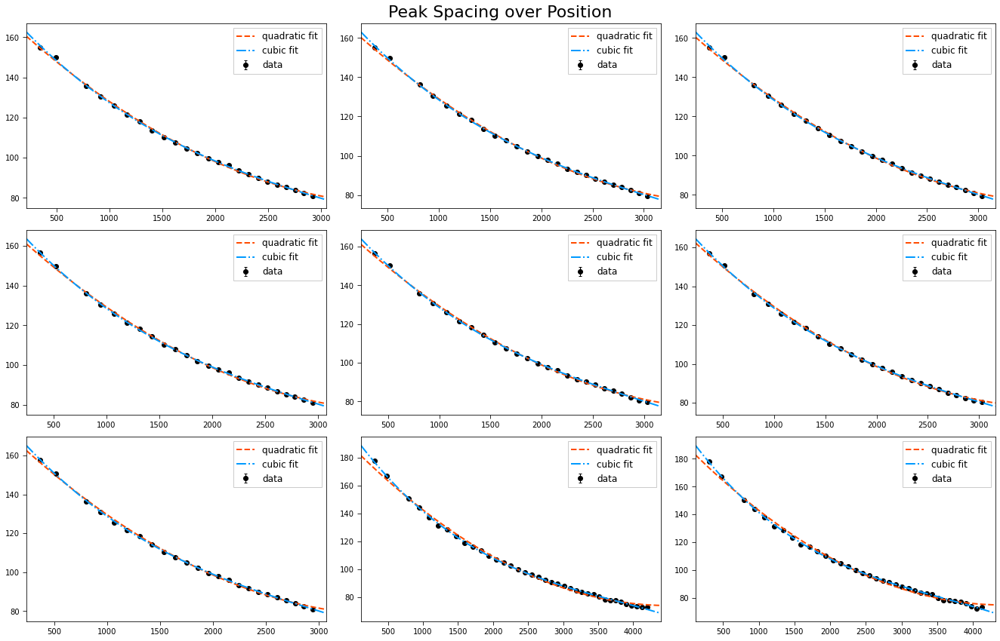

In [212]:
fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('Peak Spacing over Position', fontsize = 22)

par_2_spacing = []
par_3_spacing = []
err_2_spacing = []
err_3_spacing = []
res_2_spacing = []
res_3_spacing = []

h=0
for i in range(3):
    for j in range(3):

        dataset = np.array(spacingData[i+j+h])

        peakPositions = dataset[:,0]
        peakSpacing = dataset[:,1]
        peakErr = dataset[:,-2]

        DELTAX = peakPositions[-1] - peakPositions[0]
        XMIN = peakPositions[0] - DELTAX * 5/100
        XMAX = peakPositions[-1] + DELTAX * 5/100
        x_grid = np.linspace(XMIN, XMAX, 1000)

        par2, cov2 = curve_fit(parab, peakPositions, peakSpacing, sigma = peakErr, absolute_sigma=True)
        par3, cov3 = curve_fit(cub, peakPositions, peakSpacing, sigma = peakErr, absolute_sigma=True)

        residuals2 = peakSpacing - parab(peakPositions, *par2)
        residuals3 = peakSpacing - cub(peakPositions, *par3)

        chi2_2 = np.sum((residuals2 / np.array( peakErr ))**2)
        chi2_3 = np.sum((residuals3 / np.array( peakErr ))**2)

        err2 = np.zeros(len(par2))

        for k in range(len(par2)):
            try:
                err2[k] = cov2[k][k]**0.5
            except:
                err2[k] = 0.00

        err3 = np.zeros(len(par3))

        for k in range(len(par3)):
            try:
                err3[k] = cov3[k][k]**0.5
            except:
                err3[k] = 0.00

        ax[i][j].errorbar(peakPositions, peakSpacing, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#000000', label = 'data', zorder = 0)
        ax[i][j].plot(x_grid, parab(x_grid, *par2), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dashed', color = '#FF4B00', label = 'quadratic fit', zorder = 1)
        ax[i][j].plot(x_grid, cub(x_grid, *par3), marker = '.', markersize = 0, linewidth = 2, linestyle = '-.', color = '#009AFF', label = 'cubic fit', zorder = 2)

        ax[i][j].set_xlim(XMIN, XMAX)
        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)
        ax[i][j].legend(loc = 'upper right', prop = {'size': 12}, ncol = 1, frameon = True, fancybox = False, framealpha = 1)

        par_2_spacing.append(par2)
        par_3_spacing.append(par3)
        err_2_spacing.append(err2)
        err_3_spacing.append(err3)
        res_2_spacing.append(residuals2)
        res_3_spacing.append(residuals3)
    h+=2
fig.tight_layout()
# fig.savefig(outputPath + 'grid' + '_spacing.png', dpi = 500, facecolor = 'white')

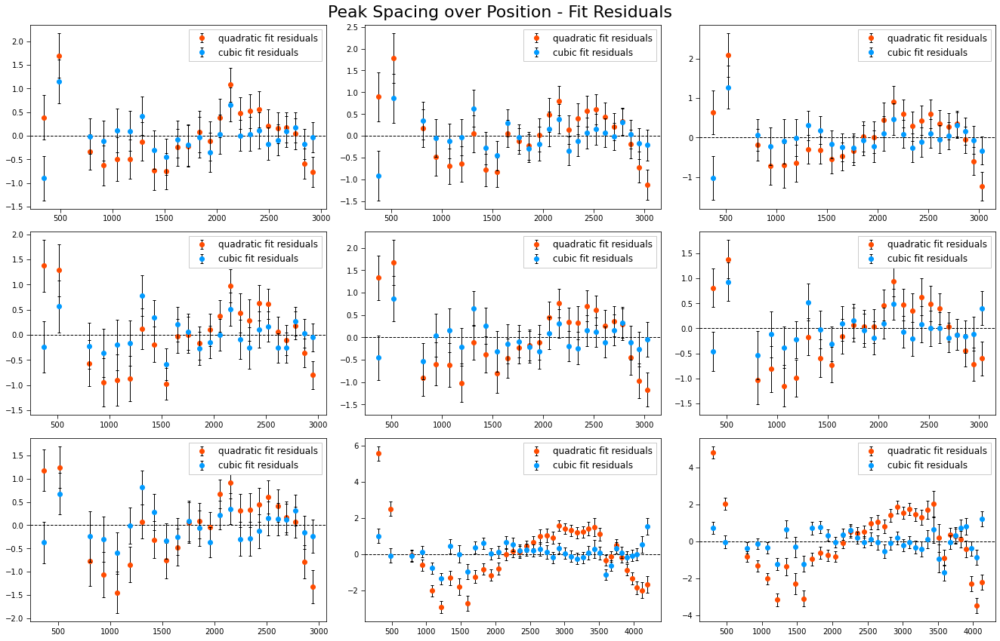

In [217]:
fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('Peak Spacing over Position - Fit Residuals', fontsize = 22)


h=0
for i in range(3):
    for j in range(3):

        dataset = np.array(spacingData[i+j+h])
        res2 = np.array(res_2_spacing[i+j+h])
        res3 = np.array(res_3_spacing[i+j+h]) 

        peakPositions = dataset[:,0]
        peakSpacing = dataset[:,1]
        peakErr = dataset[:,-2]

        DELTAX = peakPositions[-1] - peakPositions[0]
        XMIN = peakPositions[0] - DELTAX * 5/100
        XMAX = peakPositions[-1] + DELTAX * 5/100
        x_grid = np.linspace(XMIN, XMAX, 1000)

        ax[i][j].errorbar(peakPositions, res2, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#FF4B00', label = 'quadratic fit residuals', zorder = 1)
        ax[i][j].errorbar(peakPositions, res3, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#009AFF', label = 'cubic fit residuals', zorder = 2)
        ax[i][j].hlines(0, XMIN, XMAX, color='#000000', linewidth=1, linestyle='dashed', zorder=0)

        ax[i][j].set_xlim(XMIN, XMAX)
        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)
        ax[i][j].legend(loc = 'upper right', prop = {'size': 12}, ncol = 1, frameon = True, fancybox = False, framealpha = 1)
    h+=2
fig.tight_layout()
# fig.savefig(outputPath + 'grid' + '_spacing.png', dpi = 500, facecolor = 'white')

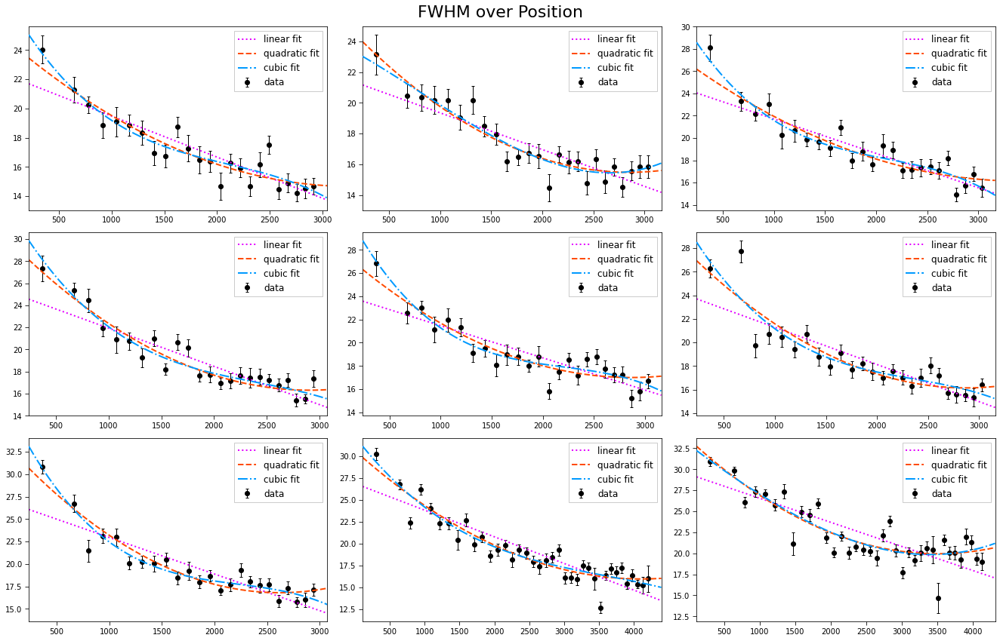

In [218]:
fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('FWHM over Position', fontsize = 22)

par_1_fwhm = []
par_2_fwhm = []
par_3_fwhm = []
err_2_fwhm = []
err_3_fwhm = []
res_1_fwhm = []
res_2_fwhm = []
res_3_fwhm = []

h = 0
for i in range(3):
    for j in range(3):
        dataset = np.array(fwhmData[i+j+h])

        peakPositions = dataset[:,0]
        peakFWHM = dataset[:,2]
        peakErr = dataset[:,-1]

        DELTAX = peakPositions[-1] - peakPositions[0]
        XMIN = peakPositions[0] - DELTAX * 5/100
        XMAX = peakPositions[-1] + DELTAX * 5/100
        x_grid = np.linspace(XMIN, XMAX, 1000)

        par1, cov1 = curve_fit(lin, peakPositions, peakFWHM, sigma = peakErr, absolute_sigma=True)
        par2, cov2 = curve_fit(parab, peakPositions, peakFWHM, sigma = peakErr, absolute_sigma=True)
        par3, cov3 = curve_fit(cub, peakPositions, peakFWHM, sigma = peakErr, absolute_sigma=True)

        residuals1 = peakFWHM - lin(peakPositions, *par1)
        residuals2 = peakFWHM - parab(peakPositions, *par2)
        residuals3 = peakFWHM - cub(peakPositions, *par3)

        chi2_2 = np.sum((residuals2 / np.array( peakErr ))**2)
        chi2_3 = np.sum((residuals3 / np.array( peakErr ))**2)

        err2 = np.zeros(len(par2))

        for k in range(len(par2)):
            try:
                err2[k] = cov2[k][k]**0.5
            except:
                err2[k] = 0.00

        err3 = np.zeros(len(par3))

        for k in range(len(par3)):
            try:
                err3[k] = cov3[k][k]**0.5
            except:
                err3[k] = 0.00

        
        ax[i][j].errorbar(peakPositions, peakFWHM, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#000000', label = 'data', zorder = 0)
        ax[i][j].plot(x_grid, lin(x_grid, *par1), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dotted', color = '#e300ff', label = 'linear fit', zorder = 1)
        ax[i][j].plot(x_grid, parab(x_grid, *par2), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dashed', color = '#FF4B00', label = 'quadratic fit', zorder = 2)
        ax[i][j].plot(x_grid, cub(x_grid, *par3), marker = '.', markersize = 0, linewidth = 2, linestyle = 'dashdot', color = '#009AFF', label = 'cubic fit', zorder = 3)

        ax[i][j].set_xlim(XMIN, XMAX)
        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)
        ax[i][j].legend(loc = 'upper right', prop = {'size': 12}, ncol = 1, frameon = True, fancybox = False, framealpha = 1)

        par_1_fwhm.append(par1)
        par_2_fwhm.append(par2)
        par_3_fwhm.append(par3)
        err_2_fwhm.append(err2)
        err_3_fwhm.append(err3)
        res_1_fwhm.append(residuals1)
        res_2_fwhm.append(residuals2)
        res_3_fwhm.append(residuals3)
    h+=2
fig.tight_layout()
# fig.savefig(outputPath + 'grid' + '_FWHM_uniform.png', dpi = 500, facecolor = 'white')

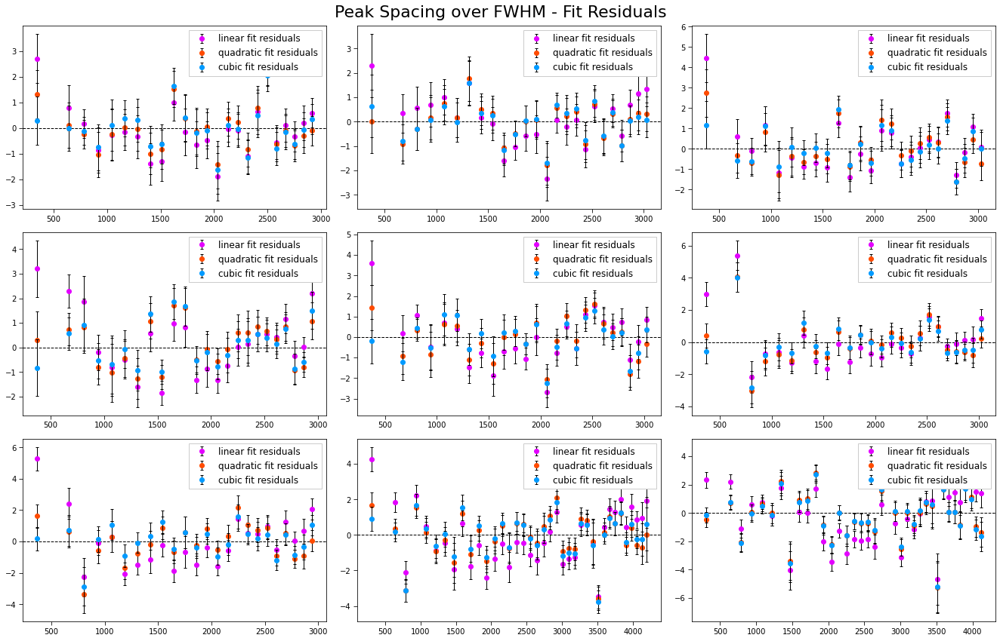

In [219]:
fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('Peak Spacing over FWHM - Fit Residuals', fontsize = 22)


h=0
for i in range(3):
    for j in range(3):

        dataset = np.array(fwhmData[i+j+h])
        res1 = np.array(res_1_fwhm[i+j+h])
        res2 = np.array(res_2_fwhm[i+j+h])
        res3 = np.array(res_3_fwhm[i+j+h]) 

        peakPositions = dataset[:,0]
        peakSpacing = dataset[:,2]
        peakErr = dataset[:,-1]

        DELTAX = peakPositions[-1] - peakPositions[0]
        XMIN = peakPositions[0] - DELTAX * 5/100
        XMAX = peakPositions[-1] + DELTAX * 5/100
        x_grid = np.linspace(XMIN, XMAX, 1000)

        ax[i][j].errorbar(peakPositions, res1, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#e300ff', label = 'linear fit residuals', zorder = 1)
        ax[i][j].errorbar(peakPositions, res2, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#FF4B00', label = 'quadratic fit residuals', zorder = 1)
        ax[i][j].errorbar(peakPositions, res3, yerr=peakErr, capsize=2, elinewidth=1, ecolor='black', marker = '.', markersize = 12, linewidth = 0, color = '#009AFF', label = 'cubic fit residuals', zorder = 2)
        ax[i][j].hlines(0, XMIN, XMAX, color='#000000', linewidth=1, linestyle='dashed', zorder=0)

        ax[i][j].set_xlim(XMIN, XMAX)
        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)
        ax[i][j].legend(loc = 'upper right', prop = {'size': 12}, ncol = 1, frameon = True, fancybox = False, framealpha = 1)
    h+=2
fig.tight_layout()
# fig.savefig(outputPath + 'grid' + '_spacing.png', dpi = 500, facecolor = 'white')

In [220]:
rel_2_spacing = []
for i in range(len(par_2_spacing)):
    rel_2_spacing.append(np.abs(err_2_spacing[i]/par_2_spacing[i])*100)

rel_3_spacing = []
for i in range(len(par_3_spacing)):
    rel_3_spacing.append(np.abs(err_3_spacing[i]/par_3_spacing[i])*100)

rel_2_fwhm = []
for i in range(len(par_2_fwhm)):
    rel_2_fwhm.append(np.abs(err_2_fwhm[i]/par_2_fwhm[i])*100)

rel_3_fwhm = []
for i in range(len(par_3_fwhm)):
    rel_3_fwhm.append(np.abs(err_3_fwhm[i]/par_3_fwhm[i])*100)

## 5 - Chi2 Minimum Check

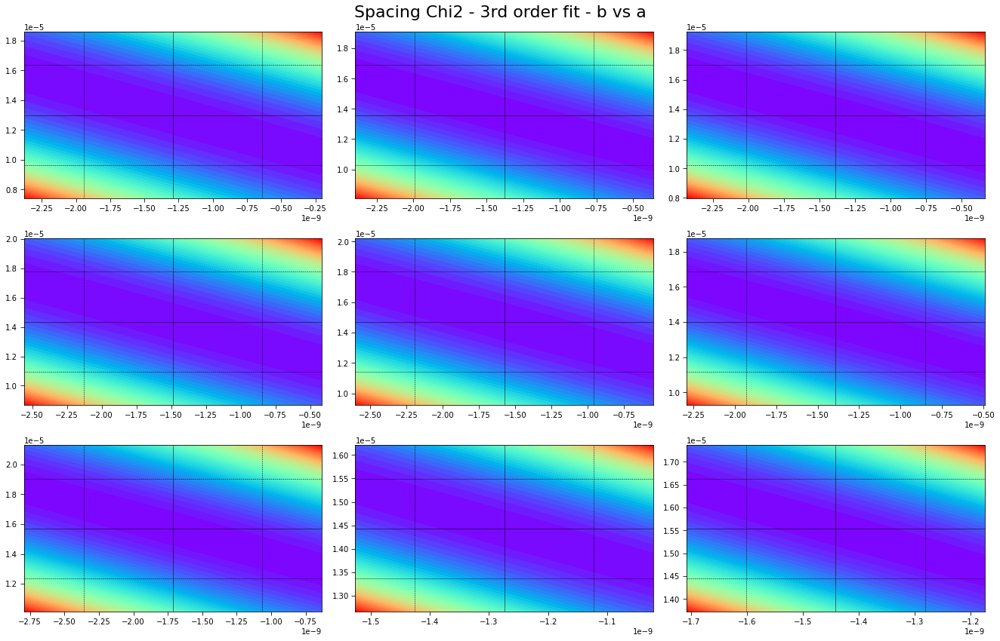

In [221]:
# SPACING - 3rd ORDER FIT

fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('Spacing Chi2 - 3rd order fit - b vs a', fontsize = 22)

nsigma = 5

h = 0
for i in range(3):
    for j in range(3):

        dataset = np.array(spacingData[i+j+h])
        peakPositions = dataset[:,0]
        peakSpacing = dataset[:,1]
        peakErr = dataset[:,-2]

        a = par_3_spacing[i+j+h][0]
        b = par_3_spacing[i+j+h][1]
        c = par_3_spacing[i+j+h][2]
        d = par_3_spacing[i+j+h][3]

        err_a = err_3_spacing[i+j+h][0]
        err_b = err_3_spacing[i+j+h][1]
        err_c = err_3_spacing[i+j+h][2]
        err_d = err_3_spacing[i+j+h][3]

        agrid = np.linspace(a-nsigma*err_a, a+nsigma*err_a, 500)
        bgrid = np.linspace(b-nsigma*err_b, b+nsigma*err_b, 500)
        cgrid = np.linspace(c-nsigma*err_c, c+nsigma*err_c, 500)
        dgrid = np.linspace(d-nsigma*err_d, d+nsigma*err_d, 500)

        aa, bb = np.meshgrid(agrid, bgrid)
        zz = chi2_cub(peakPositions, peakSpacing, peakErr, aa, bb, c, d)

        ax[i][j].contourf(agrid, bgrid, zz, levels = 50, cmap = 'rainbow')

        ax[i][j].vlines(a, b-nsigma*err_b, b+nsigma*err_b, color = '#000000', linestyle = 'solid', linewidth = 0.5)
        ax[i][j].hlines(b, a-nsigma*err_a, a+nsigma*err_a, color = '#000000', linestyle = 'solid', linewidth = 0.5)

        ax[i][j].vlines(a - 3*err_a, b-nsigma*err_b, b+nsigma*err_b, color = '#000000', linestyle = 'dashed', linewidth = 0.5)
        ax[i][j].vlines(a + 3*err_a, b-nsigma*err_b, b+nsigma*err_b, color = '#000000', linestyle = 'dashed', linewidth = 0.5)
        ax[i][j].hlines(b - 3*err_b, a-nsigma*err_a, a+nsigma*err_a, color = '#000000', linestyle = 'dashed', linewidth = 0.5)
        ax[i][j].hlines(b + 3*err_b, a-nsigma*err_a, a+nsigma*err_a, color = '#000000', linestyle = 'dashed', linewidth = 0.5)

        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)

    h+=2
fig.tight_layout()

In [ ]:
# DA FARE TUTTE LE COMBINAZIONI

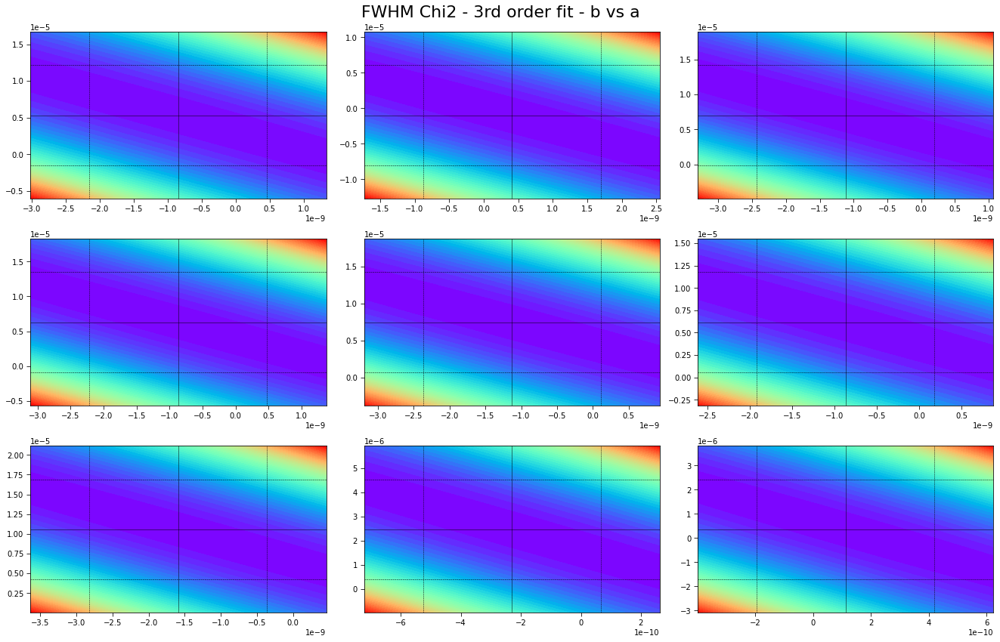

In [222]:
# FWHM - 3rd ORDER FIT

fig, ax = plt.subplots(nrows=3, ncols=3, squeeze=False, figsize=(18.5, 12))
fig.suptitle('FWHM Chi2 - 3rd order fit - b vs a', fontsize = 22)

nsigma = 5

h = 0
for i in range(3):
    for j in range(3):

        dataset = np.array(fwhmData[i+j+h])
        peakPositions = dataset[:,0]
        peakFWHM = dataset[:,2]
        peakErr = dataset[:,-1]

        a = par_3_fwhm[i+j+h][0]
        b = par_3_fwhm[i+j+h][1]
        c = par_3_fwhm[i+j+h][2]
        d = par_3_fwhm[i+j+h][3]

        err_a = err_3_fwhm[i+j+h][0]
        err_b = err_3_fwhm[i+j+h][1]
        err_c = err_3_fwhm[i+j+h][2]
        err_d = err_3_fwhm[i+j+h][3]

        agrid = np.linspace(a-nsigma*err_a, a+nsigma*err_a, 500)
        bgrid = np.linspace(b-nsigma*err_b, b+nsigma*err_b, 500)
        cgrid = np.linspace(c-nsigma*err_c, c+nsigma*err_c, 500)
        dgrid = np.linspace(d-nsigma*err_d, d+nsigma*err_d, 500)

        aa, bb = np.meshgrid(agrid, bgrid)
        zz = chi2_cub(peakPositions, peakFWHM, peakErr, aa, bb, c, d)

        ax[i][j].contourf(agrid, bgrid, zz, levels = 50, cmap = 'rainbow')

        ax[i][j].vlines(a, b-nsigma*err_b, b+nsigma*err_b, color = '#000000', linestyle = 'solid', linewidth = 0.5)
        ax[i][j].hlines(b, a-nsigma*err_a, a+nsigma*err_a, color = '#000000', linestyle = 'solid', linewidth = 0.5)

        ax[i][j].vlines(a - 3*err_a, b-nsigma*err_b, b+nsigma*err_b, color = '#000000', linestyle = 'dashed', linewidth = 0.5)
        ax[i][j].vlines(a + 3*err_a, b-nsigma*err_b, b+nsigma*err_b, color = '#000000', linestyle = 'dashed', linewidth = 0.5)
        ax[i][j].hlines(b - 3*err_b, a-nsigma*err_a, a+nsigma*err_a, color = '#000000', linestyle = 'dashed', linewidth = 0.5)
        ax[i][j].hlines(b + 3*err_b, a-nsigma*err_a, a+nsigma*err_a, color = '#000000', linestyle = 'dashed', linewidth = 0.5)

        ax[i][j].tick_params(axis = 'both', which = 'major', labelsize = 10, direction = 'out', length = 5)

    h+=2
fig.tight_layout()

In [ ]:
# DA FARE TUTTE LE COMBINAZIONI